# Identify spatial domains in the mouse spleen (bin100 and bin50) using DIRAC

- by CHANG XU changxu@nus.edu.sg.
- Last update: October 4th 2024

## Download the data （Under review, will be provided later）
- if you are have ``wget`` installed, you can run the following code to automatically download and unzip the data.

In [ ]:
# Skip this cells if data are already download
! wget -O C03833D6_bin100_Protein.h5ad "*******"
! wget -O C03833D6_bin100_RNA.h5ad "*******"
! wget -O C03833D6_bin50_Protein.h5ad "*******"
! wget -O C03833D6_bin50_RNA.h5ad "*******"

- if you do not have wget installed, manually download data from the links below:
    - Mouse spleen bin100 is collected from ADT: "**********"
    - Mouse spleen bin100 is from RNA: "***********"
    - Mouse spleen bin50 is collected from ADT: "**********"
    - Mouse spleen bin50 is from RNA: "***********"

## DIRAC's vertical integration of RNA + ADT data from the mouse spleen

In [1]:
########## load packages
import os
import random

import pandas as pd
import numpy as np
import torch
import scanpy as sc
import matplotlib.pyplot as plt

######## load dirac
import sodirac as sd

2024-12-06 11:39:25.822283: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-12-06 11:39:35.220250: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-12-06 11:39:36.690693: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1733456380.387488  484416 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1733456381.949412  484416 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-06 11:39:57.019926: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU ins

[easydl] tensorflow not available!


In [359]:
def seed_torch(seed=1029):   
    random.seed(seed)    
    # os.environ['PYTHONHASHSEED'] = str(seed)    
    np.random.seed(seed)    
    torch.manual_seed(seed)    
    torch.cuda.manual_seed(seed)    
    torch.cuda.manual_seed_all(seed) 
    # if you are using multi-GPU.    
    torch.backends.cudnn.benchmark = False    
    torch.backends.cudnn.deterministic = True

seed_torch(seed=6)

In [360]:
data_path = '/home/project/11003054/changxu/Data/Stereo_cite_seq/B05050G1/Stereo-CITE-seq'
data_name = "B05050G1_bin100"
methods = "Dirac"
save_path = "/home/project/11003054/changxu/Projects/SpaGNNs/Review/Re_2024_10_29/mouse_spleen/Results"
now = time.strftime("%Y%m%d%H%M%S", time.localtime(time.time()))

save_path = os.path.join(save_path, f"{data_name}_{methods}", f"{now}")
if not os.path.exists(save_path):
	os.makedirs(save_path)

In [361]:
adata_RNA = sc.read(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
adata_Protein = sc.read(os.path.join(data_path, f"{data_name}_Protein.h5ad"))

adata_RNA.raw = adata_RNA.copy()
adata_Protein.raw = adata_Protein.copy()

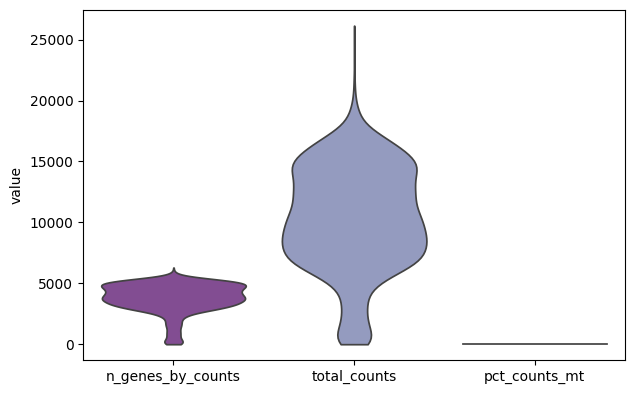

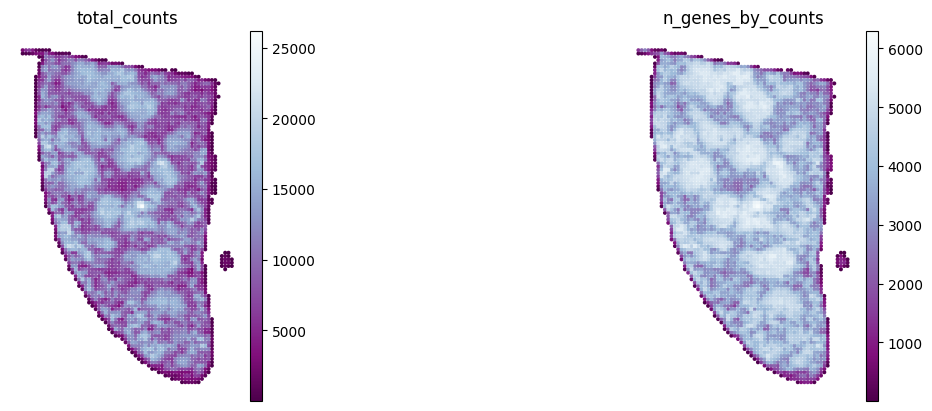

<Figure size 640x480 with 0 Axes>

In [362]:
# mitochondrial genes, "MT-" for human, "Mt-" for mouse
adata_RNA.var["mt"] = adata_RNA.var_names.str.startswith("MT-")
# ribosomal genes
adata_RNA.var["ribo"] = adata_RNA.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes
adata_RNA.var["hb"] = adata_RNA.var_names.str.contains("^HB[^(P)]")

sc.pp.calculate_qc_metrics(
    adata_RNA, qc_vars=["mt", "ribo", "hb"], inplace=True, log1p=True
)

sc.pl.violin(
    adata_RNA,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    show = False,
	stripplot=False,
    palette = "BuPu_r"
    
)
plt.savefig(os.path.join(save_path, f"{data_name}_RNA_violin_QC.pdf"), dpi=300)

sc.pl.spatial(adata_RNA, color=["total_counts", "n_genes_by_counts"], cmap = "BuPu_r", frameon=False, spot_size=120, show = False)

plt.savefig(os.path.join(save_path, f"{data_name}_RNA_spatial_QC.pdf"), dpi=300)


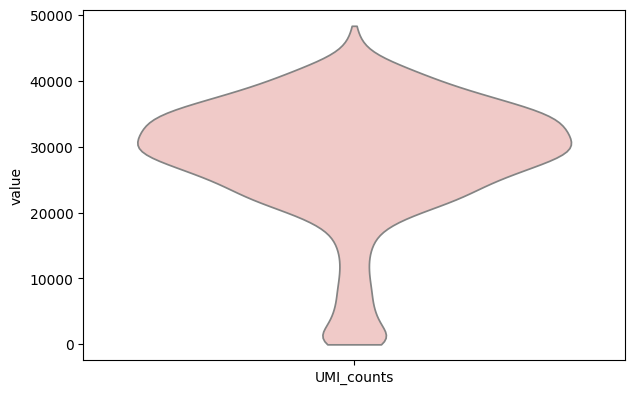

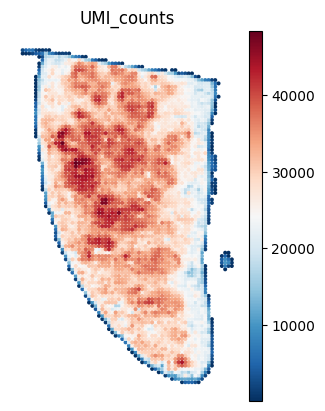

<Figure size 640x480 with 0 Axes>

In [363]:
umi_counts = adata_Protein.X.sum(axis=1).A1 if hasattr(adata_Protein.X, "A1") else adata_Protein.X.sum(axis=1)
adata_Protein.obs["UMI_counts"] = umi_counts

sc.pl.violin(
    adata_Protein,
    ["UMI_counts"],
    show = False,
	stripplot=False,
    palette = ["#F7C4C1"]
)
plt.savefig(os.path.join(save_path, f"{data_name}_Protein_violin_QC.pdf"), dpi=300)

sc.pl.spatial(adata_Protein, color=["UMI_counts"], cmap = "RdBu_r", frameon=False, spot_size=120, show = False,)

plt.savefig(os.path.join(save_path, f"{data_name}_Protein_spatial_QC.pdf"), dpi=300)

In [364]:
adata_RNA.var_names = adata_RNA.var["real_gene_name"].astype(str)
# genes_to_remove = [gene for gene in adata_RNA.var_names if gene.startswith("Gm") or gene.startswith("Mt")]
# adata_RNA = adata_RNA[:, ~adata_RNA.var_names.isin(genes_to_remove)]
# genes_filter_out = pd.read_csv("/home/project/11003054/changxu/Data/Stereo_cite_seq/genes-filter-out.csv")
# genes_filter_list = genes_filter_out['genes'].tolist()
# adata_RNA = adata_RNA[:,~adata_RNA.var_names.isin(genes_filter_list)]
# print(f"Removing {len(genes_to_remove)+len(genes_filter_list)} genes that start with 'Gm' or 'Mt' or 'Rpl'" )
# adata_RNA.var_names_make_unique()

In [365]:
adata_RNA

AnnData object with n_obs × n_vars = 4217 × 26068
    obs: 'orig.ident', 'x', 'y', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'real_gene_name', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'spatial'

In [366]:
adata_Protein

AnnData object with n_obs × n_vars = 4217 × 128
    obs: 'orig.ident', 'x', 'y', 'UMI_counts'
    var: 'real_gene_name'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'spatial'

In [367]:
common_index = adata_RNA.obs_names.intersection(adata_Protein.obs_names)
adata_RNA = adata_RNA[common_index]
adata_Protein = adata_Protein[common_index]

In [368]:
adata_RNA

View of AnnData object with n_obs × n_vars = 4217 × 26068
    obs: 'orig.ident', 'x', 'y', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'real_gene_name', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'spatial'

In [369]:
adata_Protein

View of AnnData object with n_obs × n_vars = 4217 × 128
    obs: 'orig.ident', 'x', 'y', 'UMI_counts'
    var: 'real_gene_name'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'spatial'

In [370]:
######### Data processing
adata_RNA.obs["Omics"] = data_name + "_mRNA"
adata_RNA.obs['Omics'] = adata_RNA.obs['Omics'].astype('category')
adata_Protein.obs["Omics"] = data_name + "_Protein"
adata_Protein.obs['Omics'] = adata_Protein.obs['Omics'].astype('category')

In [371]:
######### Data processing
sc.pp.filter_genes(adata_RNA, min_cells=3)
sc.pp.normalize_total(adata_RNA, target_sum=1e4)
sc.pp.log1p(adata_RNA)
sc.pp.scale(adata_RNA)
sc.tl.pca(adata_RNA, n_comps=200)

In [372]:
######### Data processing
sc.pp.normalize_total(adata_Protein, target_sum=1e4)
sc.pp.log1p(adata_Protein)
sc.pp.scale(adata_Protein)

In [373]:
adata_RNA.obsm['spatial'] = adata_RNA.obsm['spatial'].astype('float32')

In [374]:
edge_index = sd.utils.get_single_edge_index(adata_RNA.obsm["spatial"].copy(), n_neighbors = 8, graph_methods = "knn")
print(len(edge_index)/adata_RNA.shape[0])
edge_index = torch.LongTensor(edge_index).T

8.0


In [375]:
y = pd.Categorical(
            np.array(adata_RNA.obs["Omics"]),
            categories=np.unique(adata_RNA.obs["Omics"]),
        ).codes

In [376]:
###### The GPU on the server is broken, FUCK!!!!!! Training Dirac for spatial multi-omics
dirac = sd.integrate_app(save_path = save_path, use_gpu = False, subgraph=True)
samples = dirac._get_data(dataset_list = [adata_RNA.obsm["X_pca"].copy(), adata_Protein.X.copy()],
							batch_list = [y, y],
							domain_list = [np.zeros(adata_RNA.shape[0]), np.ones(adata_Protein.shape[0])],
                            edge_index = edge_index,
							num_parts = 10,
							num_workers = 1,
							batch_size = 1,)
models = dirac._get_model(samples, 
						n_hiddens = 128,
        				n_outputs = 64,
        				opt_GNN = "GCN",) 
data_z, combine_recon, _ = dirac._train_dirac_integrate(samples = samples,
							models = models,
							epochs = 50,
                            lamb = 5e-4, 
                    		scale_loss = 0.5,
                            lr = 1e-3,
                            wd = 5e-2,
    						)

Found 2 unique domains.


Computing METIS partitioning...
Done!
Project..: 100%|█| 50/50 [04:53<00:00,  5.88s/it, Loss


In [377]:
adata_RNA.obsm[f"{methods}_embed"] = data_z[: adata_RNA.shape[0], :]
adata_Protein.obsm[f"{methods}_embed"] = data_z[adata_RNA.shape[0] :, :]
adata_RNA.obsm["combine_recon"] = combine_recon
adata_Protein.obsm["combine_recon"] = combine_recon

Best resolution:  0.14
fitting ...
  |======================================================================| 100%


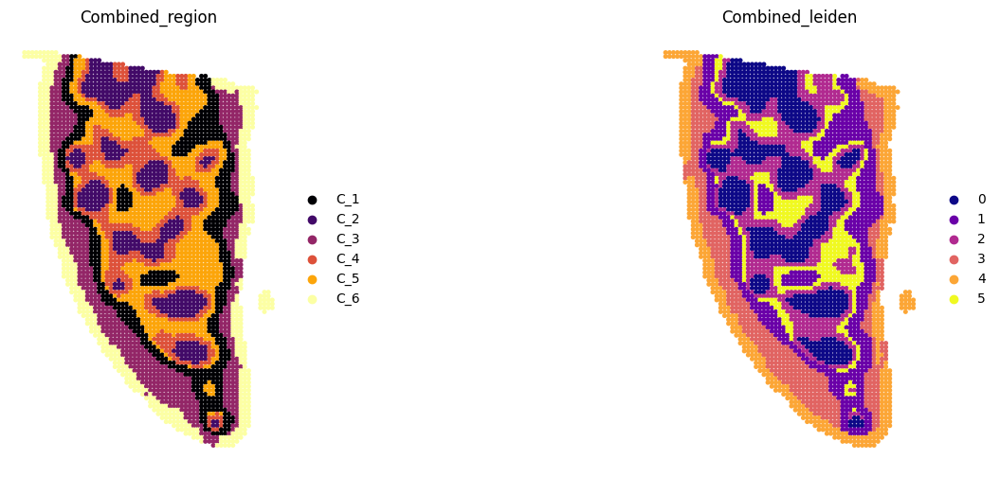

In [378]:
####### Combined
n_clusters = 6
sc.pp.neighbors(adata_RNA, use_rep='combine_recon')
res_RNA_Protein = _priori_cluster(adata_RNA, eval_cluster_n=n_clusters)
sc.tl.leiden(adata_RNA, resolution=res_RNA_Protein, key_added="Combined_leiden")
mclust_R(adata=adata_RNA, num_cluster=n_clusters, used_obsm="combine_recon", key_added="Combined_mclust")

adata_RNA.obs["Combined_region"] = "C_" + adata_RNA.obs["Combined_mclust"].astype(str)
adata_RNA.obs["Combined_region"] = adata_RNA.obs["Combined_region"].astype('category')
adata_RNA.uns["__type"] = 'UMI'

# Create a color dictionary for the "Combined_region" category
colors_list = plt.cm.get_cmap("inferno", len(adata_RNA.obs["Combined_region"].unique())).colors
color_dict = dict(zip(adata_RNA.obs["Combined_region"].cat.categories, colors_list))

# Set the number of panels and layout for the subplot
n_panels = 2
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Define color palettes and colormaps
colors = ["Combined_region", "Combined_leiden"]
colormaps = [color_dict, "plasma"]  # Example colormaps; modify as needed

# Plot each panel
for ax, color, cmap in zip(axs, colors, colormaps):
    sc.pl.spatial(adata_RNA, color=color, palette=cmap, frameon=False, spot_size=120, ax=ax, show=False)
    ax.set_title(color)

adata_RNA.uns["Combined_region_colors"] = color_dict

# Save the figure to the specified path with a filename including a timestamp; set high resolution and remove extra margins
file_name = f"{data_name}_{methods}_Combined_spatial_{now}.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)

Best resolution:  0.24000000000000005
fitting ...
  |======================================================================| 100%


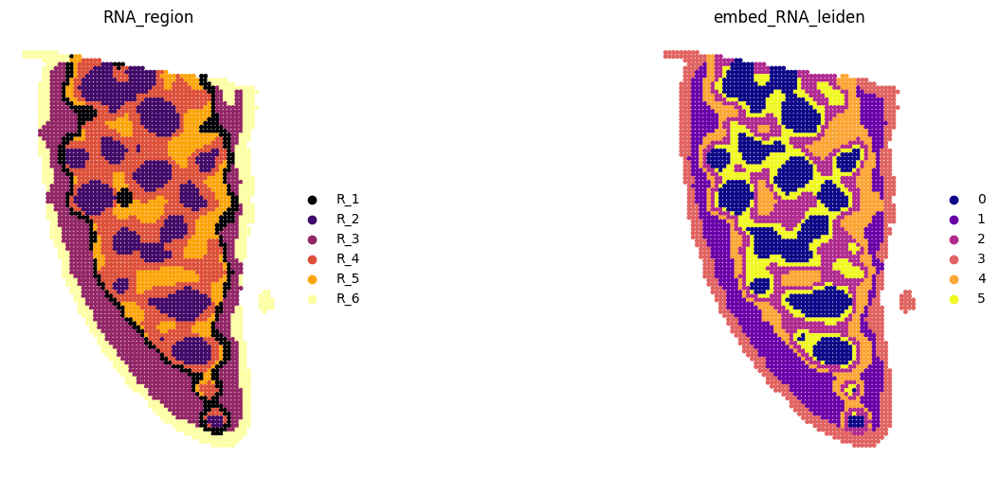

In [379]:
####### RNA
sc.pp.neighbors(adata_RNA, use_rep=f"{methods}_embed", n_neighbors=20)
res_RNA_Protein = _priori_cluster(adata_RNA, eval_cluster_n=n_clusters)
sc.tl.leiden(adata_RNA, resolution=res_RNA_Protein, key_added="embed_RNA_leiden")
mclust_R(adata=adata_RNA, num_cluster=n_clusters, used_obsm=f"{methods}_embed", key_added="embed_RNA_mclust")

adata_RNA.obs["RNA_region"] = "R_" + adata_RNA.obs["embed_RNA_mclust"].astype(str)
adata_RNA.obs["RNA_region"] = adata_RNA.obs["RNA_region"].astype('category')

# Create a color dictionary for the "RNA_region" category
colors_list = plt.cm.get_cmap("inferno", len(adata_RNA.obs["RNA_region"].unique())).colors
color_dict = dict(zip(adata_RNA.obs["RNA_region"].cat.categories, colors_list))

# Set the number of panels and layout for the subplot
n_panels = 2
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Define color palettes and colormaps
colors = ["RNA_region", "embed_RNA_leiden"]
colormaps = [color_dict, "plasma"]  # Example colormaps; modify as needed

# Plot each panel
for ax, color, cmap in zip(axs, colors, colormaps):
    sc.pl.spatial(adata_RNA, color=color, palette=cmap, frameon=False, spot_size=120, ax=ax, show=False)
    ax.set_title(color)

adata_RNA.uns["RNA_region_colors"] = color_dict

# Save the figure to the specified path with a filename including a timestamp; set high resolution and remove extra margins
file_name = f"{data_name}_{methods}_RNA_spatial_{now}.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)

Best resolution:  0.18000000000000002
fitting ...
  |======================================================================| 100%


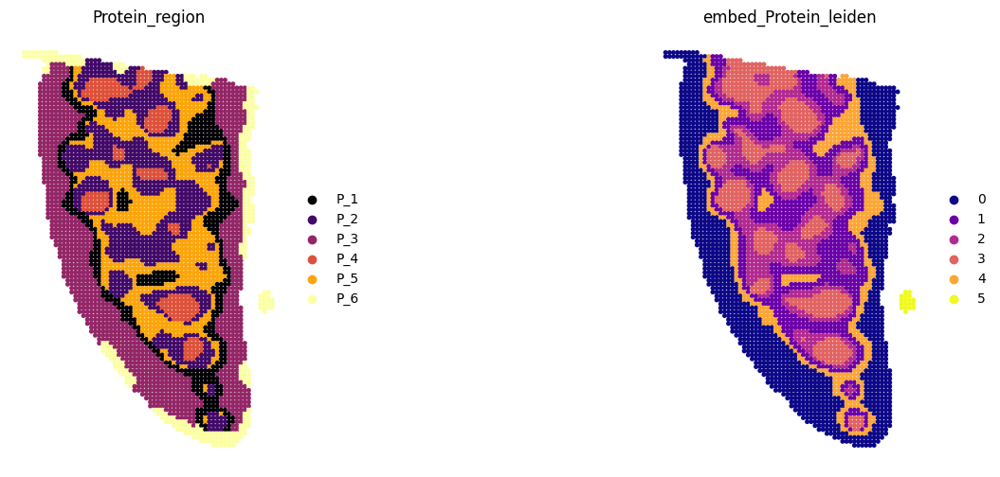

In [380]:
###### Protein
sc.pp.neighbors(adata_Protein, use_rep=f"{methods}_embed", n_neighbors=20)
res_RNA_Protein = _priori_cluster(adata_Protein, eval_cluster_n=n_clusters)
sc.tl.leiden(adata_Protein, resolution=res_RNA_Protein, key_added="embed_Protein_leiden")
mclust_R(adata=adata_Protein, num_cluster=n_clusters, used_obsm=f"{methods}_embed", key_added="embed_Protein_mclust")

adata_Protein.obs["Protein_region"] = "P_" + adata_Protein.obs["embed_Protein_mclust"].astype(str)
adata_Protein.obs["Protein_region"] = adata_Protein.obs["Protein_region"].astype('category')

# Create a color dictionary for the "Protein_region" category
colors_list = plt.cm.get_cmap("inferno", len(adata_Protein.obs["Protein_region"].unique())).colors
color_dict = dict(zip(adata_Protein.obs["Protein_region"].cat.categories, colors_list))

# Set the number of panels and layout for the subplot
n_panels = 2
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Define color palettes and colormaps
colors = ["Protein_region", "embed_Protein_leiden"]
colormaps = [color_dict, "plasma"]  # Example colormaps; modify as needed

# Plot each panel
for ax, color, cmap in zip(axs, colors, colormaps):
    sc.pl.spatial(adata_Protein, color=color, palette=cmap, frameon=False, spot_size=120, ax=ax, show=False)
    ax.set_title(color)

adata_Protein.uns["Protein_region_colors"] = color_dict

# Save the figure to the specified path with a filename including a timestamp; set high resolution and remove extra margins
file_name = f"{data_name}_{methods}_Protein_spatial_{now}.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)


Best resolution:  0.18000000000000002
fitting ...
  |======================================================================| 100%


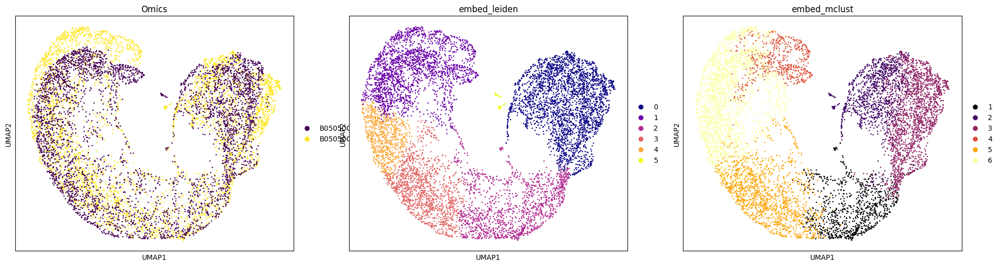

In [381]:
adata = anndata.AnnData(data_z)
adata.obs = pd.concat([adata_RNA.obs, adata_Protein.obs])
adata.obsm[f"{methods}_embed"] = data_z
sc.pp.neighbors(adata, use_rep='X')
sc.tl.umap(adata)
res_RNA_Protein = _priori_cluster(adata, eval_cluster_n=n_clusters)
sc.tl.leiden(adata, resolution=res_RNA_Protein, key_added="embed_leiden")
mclust_R(adata=adata, num_cluster=n_clusters, used_obsm=f"{methods}_embed", key_added="embed_mclust")

# Set the number of panels and layout for the subplot
n_panels = 3
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Define color palettes and colormaps
colors = ['Omics', "embed_leiden", "embed_mclust"]
colormaps = ["viridis", "plasma", "inferno"]  # Example colormaps; modify as needed

# Plot each panel
for ax, color, cmap in zip(axs, colors, colormaps):
    sc.pl.umap(adata, color=color, palette=cmap, ax=ax, show=False)
    ax.set_title(color)

# Save the figure to the specified path with a filename including a timestamp; set high resolution and remove extra margins
file_name = f"{data_name}_{methods}_embed_umap_{now}.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)

# Close the figure to free memory
plt.close(fig)


In [382]:
adata_RNA.obs["embed_leiden"] = adata.obs["embed_leiden"][adata.obs["Omics"] == data_name + "_mRNA"]
adata_Protein.obs["embed_leiden"] = adata.obs["embed_leiden"][adata.obs["Omics"] == data_name + "_Protein"]
adata_RNA.obs["embed_mclust"] = adata.obs["embed_mclust"][adata.obs["Omics"] == data_name + "_mRNA"]
adata_Protein.obs["embed_mclust"] = adata.obs["embed_mclust"][adata.obs["Omics"] == data_name + "_Protein"]

In [384]:
####### Save Data
adata_RNA.var.rename(columns={"real_gene_name": "real_gene_name_col"}, inplace=True)
adata.write(os.path.join(save_path,f"{data_name}_{methods}_RNA_Protein_{now}.h5ad"),compression="gzip")
adata_RNA.write(os.path.join(save_path,f"{data_name}_{methods}_RNA_{now}.h5ad"),compression="gzip")
adata_Protein.write(os.path.join(save_path,f"{data_name}_{methods}_Protein_{now}.h5ad"),compression="gzip")

In [385]:
save_path

'/home/project/11003054/changxu/Projects/SpaGNNs/Review/Re_2024_10_29/mouse_spleen/Results/B05050G1_bin100_Dirac/20241206164031'

In [386]:
print(adata_RNA.uns["Combined_region_colors"])

{'C_1': array([1.4620e-03, 4.6600e-04, 1.3866e-02, 1.0000e+00]), 'C_2': array([0.258234, 0.038571, 0.406485, 1.      ]), 'C_3': array([0.578304, 0.148039, 0.404411, 1.      ]), 'C_4': array([0.865006, 0.316822, 0.226055, 1.      ]), 'C_5': array([0.987622, 0.64532 , 0.039886, 1.      ]), 'C_6': array([0.988362, 0.998364, 0.644924, 1.      ])}


## Spatial domain names and differential gene and protein expression

In [1]:
import spateo as st

save_time = "20241206164031"

data_path = '/home/project/11003054/changxu/Data/Stereo_cite_seq/B05050G1/Stereo-CITE-seq'
data_name = "B05050G1_bin100"
methods = "Dirac"
save_path = f'/home/project/11003054/changxu/Projects/SpaGNNs/Review/Re_2024_10_29/mouse_spleen/Results/B05050G1_bin100_Dirac/{save_time}'

adata_RNA = sc.read(os.path.join(save_path,f"{data_name}_{methods}_RNA_{save_time}.h5ad"))
adata_Protein = sc.read(os.path.join(save_path,f"{data_name}_{methods}_Protein_{save_time}.h5ad"))

adata_RNA = adata_RNA.raw.to_adata()
adata_Protein = adata_Protein.raw.to_adata()

######

2024-12-06 20:44:40.677240: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-12-06 20:44:40.680245: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-12-06 20:44:40.688043: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1733489080.700808 4100607 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1733489080.704716 4100607 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-06 20:44:40.719404: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU ins

In [2]:
adata_RNA.var_names = adata_RNA.var["real_gene_name"].astype(str)

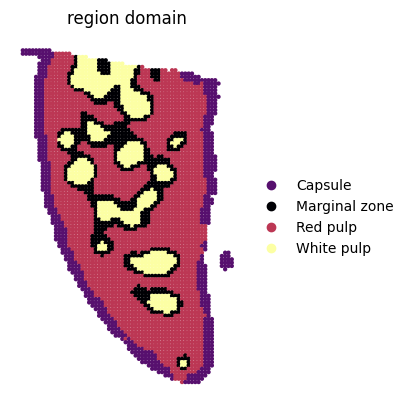

In [3]:
# create a dictionary to map cluster to annotation label
cluster2annotation = {
    "C_1": "Red pulp",
    "C_2": "White pulp",
    "C_3": "Red pulp",
    "C_4": "Marginal zone",
    "C_5": "Red pulp",
    "C_6": "Capsule",
}

# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata_RNA.obs["region domain"] = adata_RNA.obs['Combined_region'].map(cluster2annotation).astype("category")

########### save colors
cluster2colors = {
    "Marginal zone": '#000004ff',
    "Capsule": '#57106eff',
    "White pulp": '#fcffa4ff',
    "Blood vessel":'#f98e09ff',
    "Red pulp":'#bc3754ff',
}
sc.pl.spatial(adata_RNA, color=["region domain"], palette=cluster2colors, frameon=False, spot_size=130, show=False)
plt.savefig(os.path.join(save_path, f"{data_name}_bin100_region_domain.pdf"), dpi=300)

In [4]:
genes_to_remove = [gene for gene in adata_RNA.var_names if gene.startswith("Gm") or gene.startswith("Mt")]
adata_RNA = adata_RNA[:, ~adata_RNA.var_names.isin(genes_to_remove)]

genes_filter_out = pd.read_csv("/home/project/11003054/changxu/Data/Stereo_cite_seq/genes-filter-out.csv")
genes_filter_list = genes_filter_out['genes'].tolist()
adata_RNA = adata_RNA[:,~adata_RNA.var_names.isin(genes_filter_list)]
print(f"Removing {len(genes_to_remove)+len(genes_filter_list)} genes that start with 'Gm' or 'Mt' or 'Rpl'" )
adata_RNA.var_names_make_unique()

Removing 5342 genes that start with 'Gm' or 'Mt' or 'Rpl'


/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.



In [5]:
sc.pp.normalize_total(adata_RNA, target_sum=1e4)
sc.pp.log1p(adata_RNA)
adata_RNA.raw = adata_RNA.copy()
# sc.pp.highly_variable_genes(adata_RNA, flavor="seurat_v3_paper", n_top_genes=2000, subset=True)
sc.tl.rank_genes_groups(adata_RNA, groupby="region domain", method="wilcoxon") #, use_raw=False

In [6]:
result = adata_RNA.uns["rank_genes_groups"]
groups = result["names"].dtype.names
pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names', 'pvals','pvals_adj','logfoldchanges']}).to_csv(os.path.join(save_path, f'{data_name}_{methods}_markerGenes.csv'))

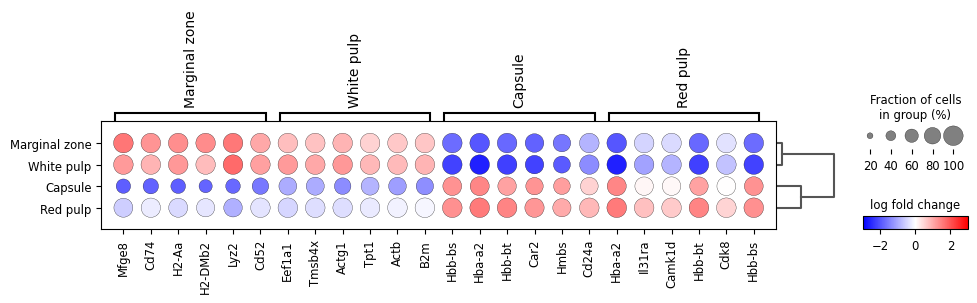

In [7]:
sc.pl.rank_genes_groups_dotplot(
    adata_RNA,
    n_genes=6,
    values_to_plot="logfoldchanges",
    min_logfoldchange=0.5,
    vmax=3,
    vmin=-3,
    cmap="bwr",
)

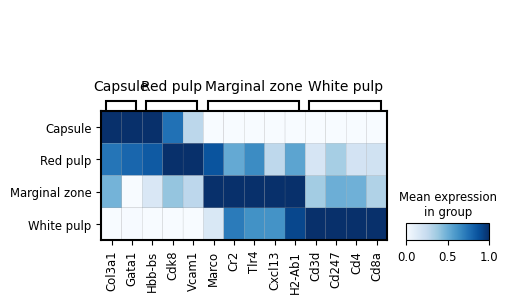

In [14]:
# marker_genes = { 
#  'Capsule': ['Col3a1','Hbb-bs', 'Gata1'], 
#  'Red pulp': ['Hba-a2','Gab1', 'Timd2', 'Cd36', 'Cd68'], 
#  'Marginal zone': ['Marco', 'Cr2', 'Cxcl13',"Tlr4",],
#  'White pulp': ['Cd3e','Cd3d', 'Cd247', 'Fn1', 'Ccr7', 'Il7r','Cd4', 'Cd8a'],
# }

# marker_genes = { 
#  'Capsule': ['Col3a1','Hbb-bs', 'Gata1'], 
#  'Red pulp': [
#     "Cd68",
#     "Mpo",
#     "Fth1",
#     "Cx3cr1",
#     "Il6",
#     "Itgam",
#     "Hba-a1",
#     "Fos",
#     "Tlr4"
# ], 
#  'Marginal zone': [
#     "Fcer1g",
#     "Fth1",
#     "Tlr4",
#     "Ccr7",
#     "Il10",
#     "Ccl3",
#     "Ccl5",
#     "Nkg7",
#     "Rag1"
# ],
#  'White pulp': [
#     "Cd3e",
#     "Cd4",
#     "Cd8a",
#     "Il2ra",
#     "Foxp3",
#     "Lck",
#     "Il7r",
#     "Aicda",
#     "Ccl19"
# ],
# }

region_order = ['Capsule', 'Red pulp', 'Marginal zone', 'White pulp']
adata_RNA.obs['region domain'] = pd.Categorical(
    adata_RNA.obs['region domain'], categories=region_order, ordered=True
)

marker_genes = { 
 'Capsule': ['Col3a1','Gata1'], 
 'Red pulp': ["Hbb-bs",'Cdk8','Vcam1'], 
 'Marginal zone': ['Marco', 'Cr2', 'Tlr4', 'Cxcl13','H2-Ab1'],
 'White pulp': ['Cd3d', 'Cd247', 'Cd4', 'Cd8a'],
}

fig, ax = plt.subplots(figsize=(5, 3))
sc.pl.matrixplot(
    adata_RNA,
    marker_genes, # as a dictionary, will be sorted
    groupby="region domain",
    dendrogram=False,
    use_raw=False,
    standard_scale = "var",
    cmap = "Blues",
    var_group_rotation = 0,
    # swap_axes = True,
    # save = os.path.join(save_path,"bin100_region_marker_genes.pdf"),
    ax=ax,
)

fig.savefig(os.path.join(save_path,"bin100_region_marker_genes.pdf"), dpi = 300)

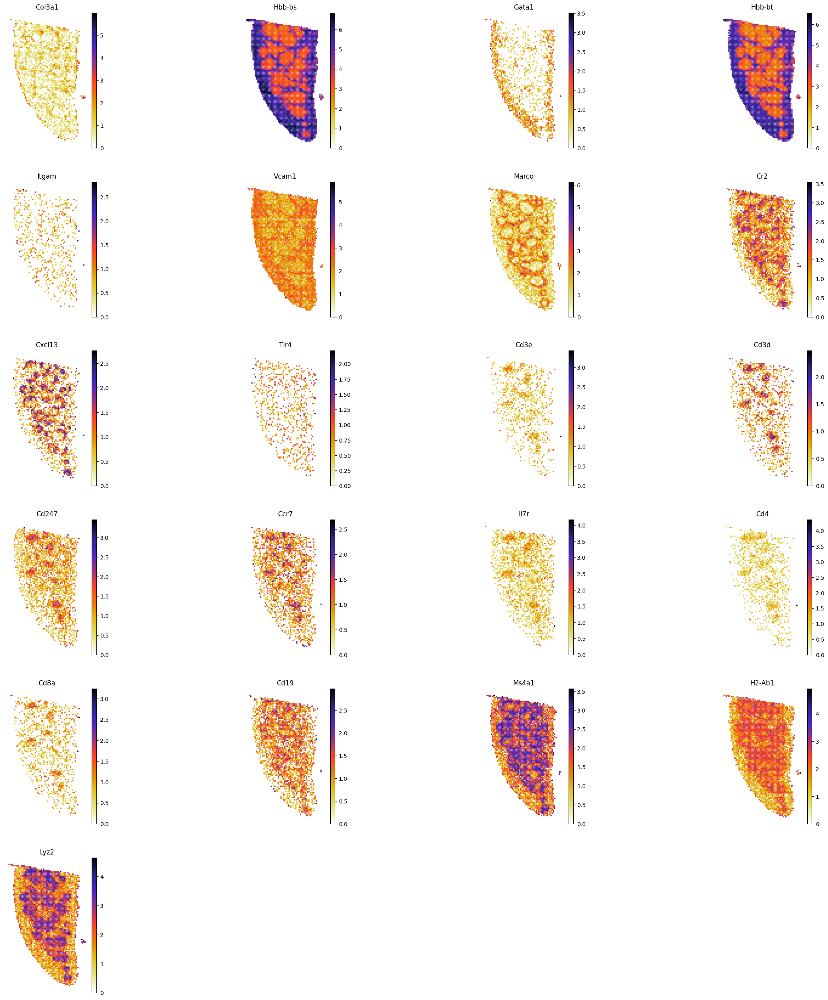

In [425]:
# gene_list=['Marco', 'Cr2', 'Cxcl13','Angpt1', 'Hbb-bs', 'Gata1', 'Cd36','Cd3e','Cd3d', 'Cd247', \
#            'Fn1', 'Ccr7', 'Il7r','Cd4', 'Cd8a','Col1a1', 'Col4a1', 'Gsn', 'Cd34', 'Mgp', 'Col3a1', \
#           'Cd163','Gab1', 'Timd2']

gene_list=['Col3a1','Hbb-bs', 'Gata1',"Hbb-bt",'Itgam','Vcam1','Marco', 'Cr2', 'Cxcl13', 'Tlr4','Cd3e',
           'Cd3d', 'Cd247', 'Ccr7', 'Il7r','Cd4', 'Cd8a', 'Cd19', 'Ms4a1', 'H2-Ab1', 'Lyz2']

filtered_gene_list = [gene for gene in gene_list if gene in adata_RNA.var_names]

sc.pl.spatial(adata_RNA, color=filtered_gene_list, frameon=False, spot_size=120, cmap = 'CMRmap_r', show=False)
plt.savefig(os.path.join(save_path,f"{data_name}_genes.pdf"), bbox_inches='tight', dpi=300)

In [427]:
All_proteins = adata_Protein.var_names.tolist()

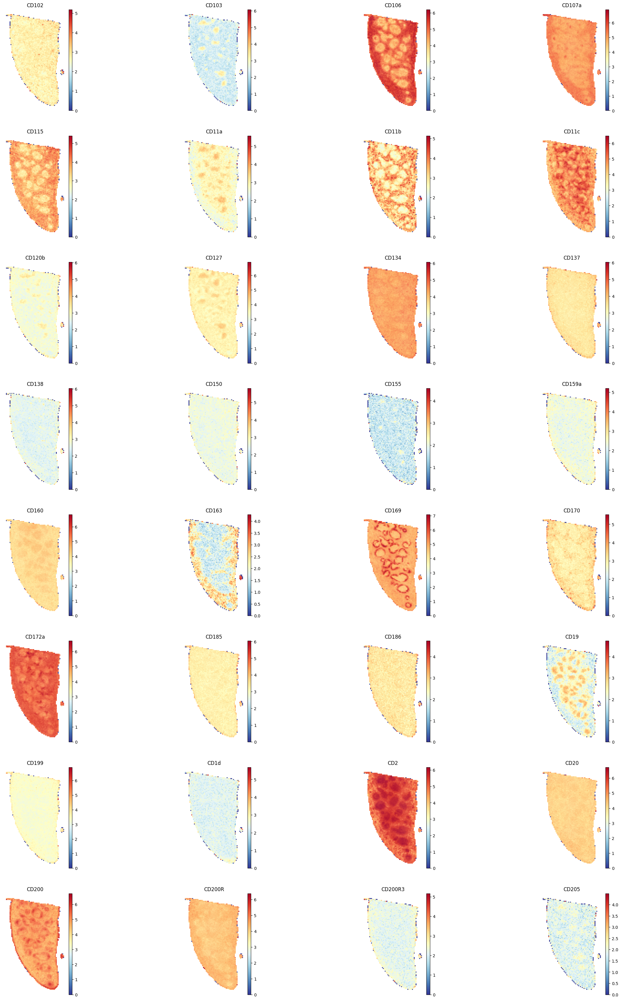

In [429]:
sc.pl.spatial(adata_Protein, color=All_proteins[:32], frameon=False, spot_size=120, cmap = 'RdYlBu_r', show=False)
plt.savefig(os.path.join(save_path,f"{data_name}_proteins_section1.pdf"), bbox_inches='tight', dpi=300)

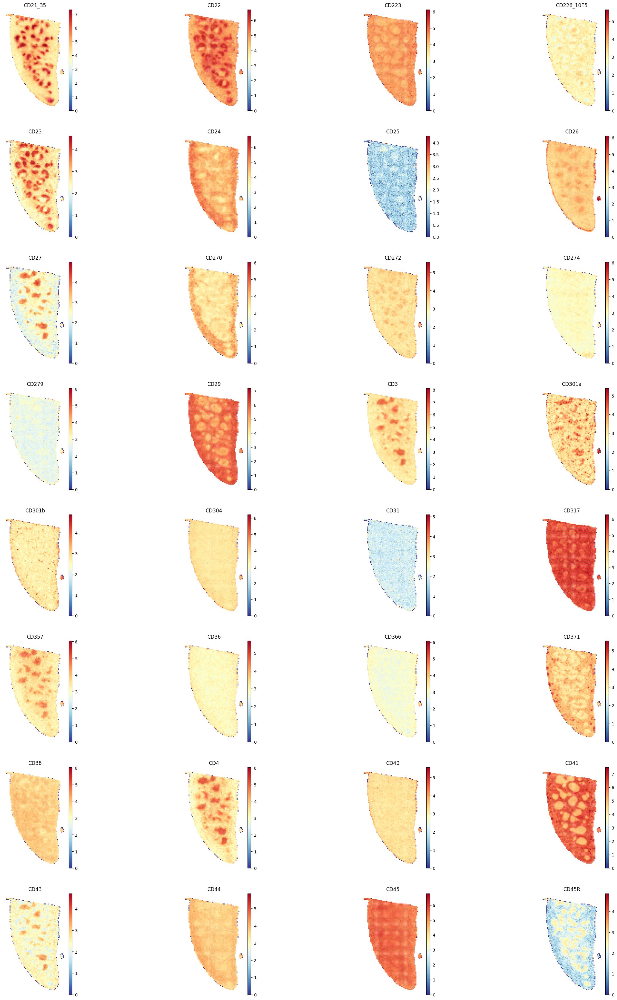

In [430]:
sc.pl.spatial(adata_Protein, color=All_proteins[32:64], frameon=False, spot_size=120, cmap = 'RdYlBu_r', show=False)
plt.savefig(os.path.join(save_path,f"{data_name}_proteins_section2.pdf"), bbox_inches='tight', dpi=300)

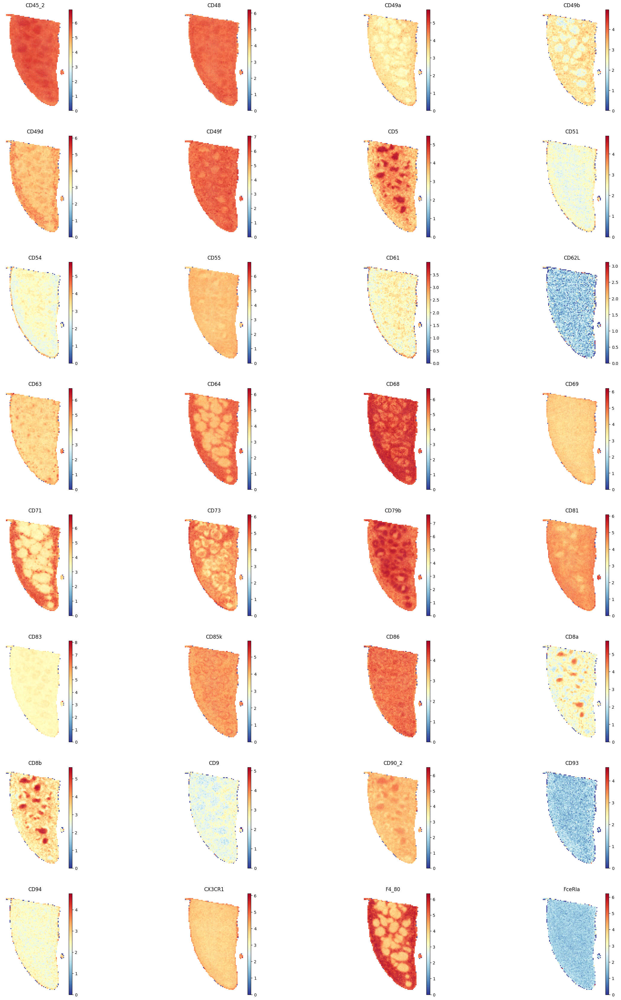

In [431]:
sc.pl.spatial(adata_Protein, color=All_proteins[64:96], frameon=False, spot_size=120, cmap = 'RdYlBu_r', show=False)
plt.savefig(os.path.join(save_path,f"{data_name}_proteins_section3.pdf"), bbox_inches='tight', dpi=300)

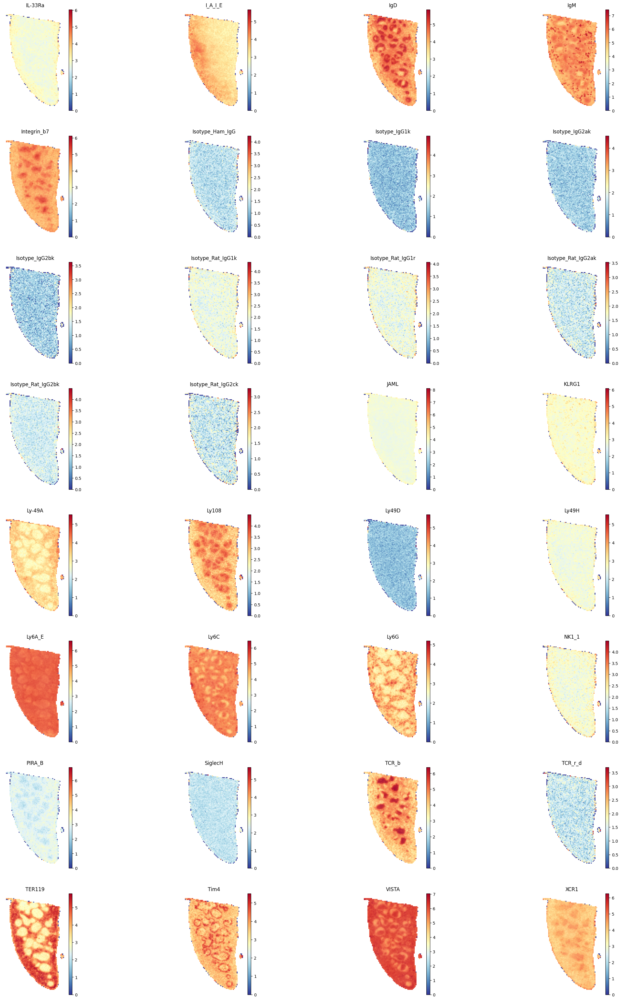

In [432]:
sc.pl.spatial(adata_Protein, color=All_proteins[96:], frameon=False, spot_size=120, cmap = 'RdYlBu_r', show=False)
plt.savefig(os.path.join(save_path,f"{data_name}_proteins_section4.pdf"), bbox_inches='tight', dpi=300)

In [439]:
sc.pp.normalize_total(adata_Protein, target_sum=1e4)
sc.pp.log1p(adata_Protein)

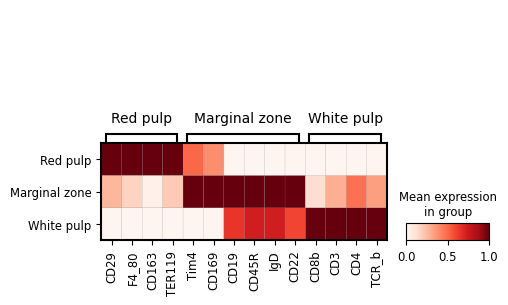

In [441]:
adata_Protein.obs["region domain"] = adata_RNA.obs["region domain"]
region_order = ['Capsule', 'Red pulp', 'Marginal zone', 'White pulp']
adata_Protein.obs['region domain'] = pd.Categorical(
    adata_Protein.obs['region domain'], categories=region_order, ordered=True
)
marker_proteins = { 
 'Red pulp': ['CD29','F4_80','CD163', 'TER119'], 
 'Marginal zone': ['Tim4','CD169', 'CD19','CD45R', 'IgD','CD22'], 
 'White pulp': ["CD8b", "CD3", "CD4", 'TCR_b'],
}

fig, ax = plt.subplots(figsize=(5, 3))
sc.pl.matrixplot(
    adata_Protein[adata_Protein.obs['region domain'].isin(['Marginal zone','White pulp','Red pulp'])],
    marker_proteins, # as a dictionary, will be sorted
    groupby="region domain",
    dendrogram=False,
    use_raw=False,
    standard_scale = "var",
    cmap = "Reds",
    var_group_rotation = 0,
    # swap_axes = True,
    # save = os.path.join(save_path,"bin100_region_marker_genes.pdf"),
    ax=ax,
)

fig.savefig(os.path.join(save_path,"bin100_region_marker_proteins.pdf"), dpi = 300)

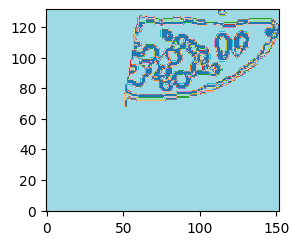

In [443]:
st.pl.spatial_domains(adata_RNA, bin_size=100, label_key="region domain", save_img=os.path.join(save_path, "spatial_domains.png"))

In [444]:
adata_RNA.obsm['spatial_bin100'] = adata_RNA.obsm['spatial']//100

# Load spatial domain image as background
# adata_celltype = sc.read("")


adata_RNA = st.io.read_image(
    adata_RNA,
    filename=os.path.join(save_path, "spatial_domains.png"),
    img_layer="layer1",
    slice="slice1",
    scale_factor=1,
)

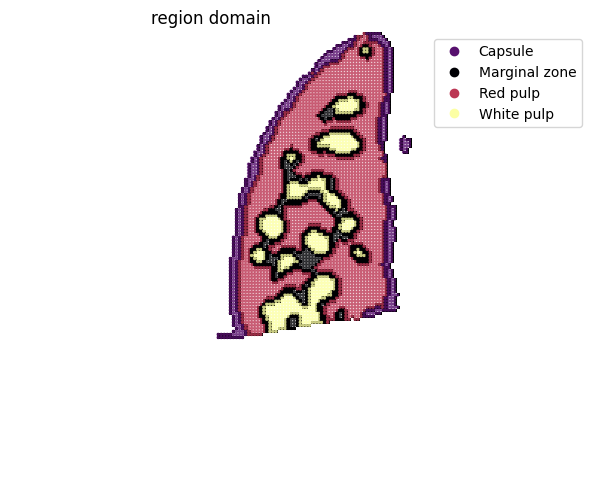

<Figure size 640x480 with 0 Axes>

In [447]:
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA,
    space="spatial_bin100",
    color=["region domain"],
    alpha=0.8,
    figsize=(5, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    dpi=300, 
    pointsize=0.1,
    color_key = adata_RNA.uns['region domain_colors'],
    ax=ax,
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains.png"))

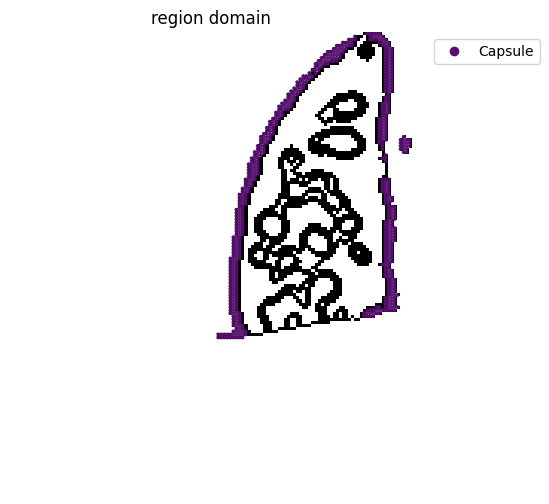

<Figure size 640x480 with 0 Axes>

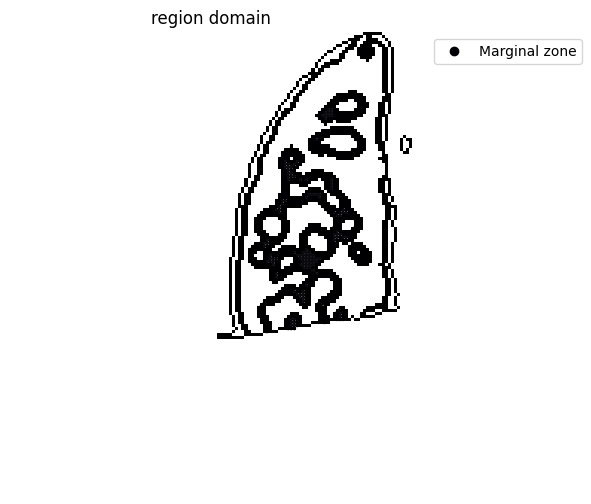

<Figure size 640x480 with 0 Axes>

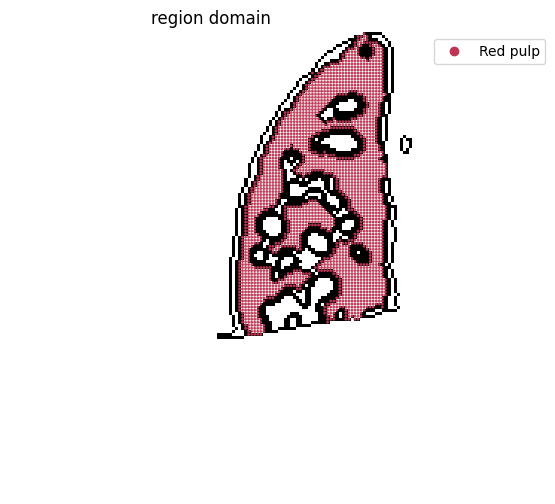

<Figure size 640x480 with 0 Axes>

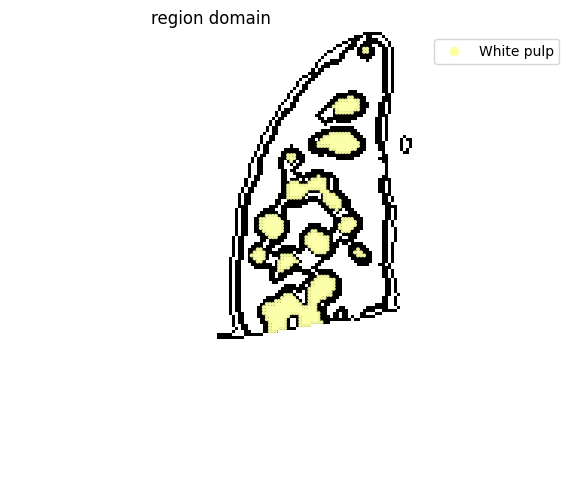

<Figure size 640x480 with 0 Axes>

In [449]:
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA[adata_RNA.obs["region domain"].isin(["Capsule"]), :],
    space="spatial_bin100",
    color=["region domain"],
    alpha=0.95,
    pointsize=0.05,
    figsize=(4, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    color_key = adata_RNA.uns['region domain_colors'],
    ax = ax
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_Capsule.png"))

fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA[adata_RNA.obs["region domain"].isin(["Marginal zone"]), :],
    space="spatial_bin100",
    color=["region domain"],
    alpha=0.95,
    pointsize=0.05,
    figsize=(4, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    color_key = adata_RNA.uns['region domain_colors'],
    ax = ax
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_MZ.png"))

fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA[adata_RNA.obs["region domain"].isin(["Red pulp"]), :],
    space="spatial_bin100",
    color=["region domain"],
    alpha=0.95,
    pointsize=0.05,
    figsize=(4, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    color_key = adata_RNA.uns['region domain_colors'],
    ax = ax
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_RP.png"))

fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA[adata_RNA.obs["region domain"].isin(["White pulp"]), :],
    space="spatial_bin100",
    color=["region domain"],
    alpha=0.95,
    pointsize=0.05,
    figsize=(4, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    color_key = adata_RNA.uns['region domain_colors'],
    ax = ax
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_WP.png"))

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:900: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:900: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(


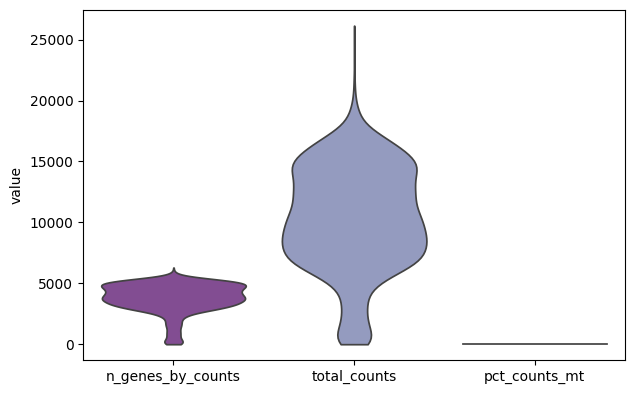

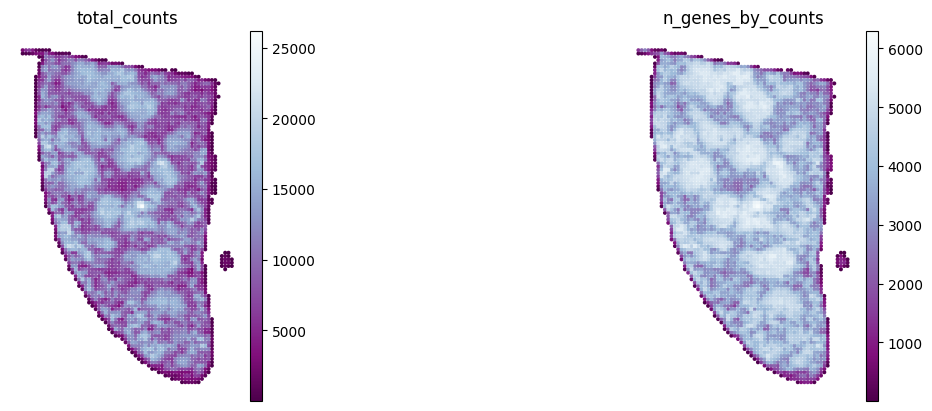

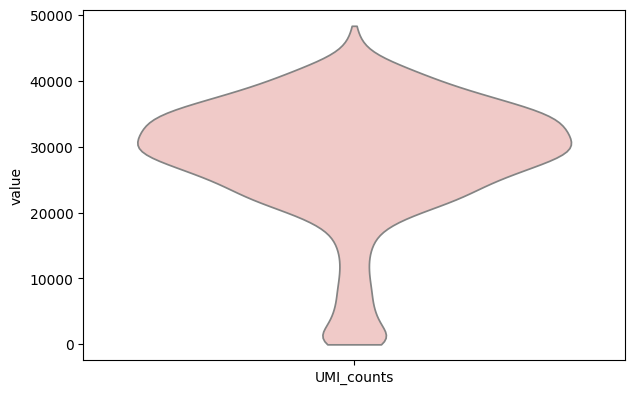

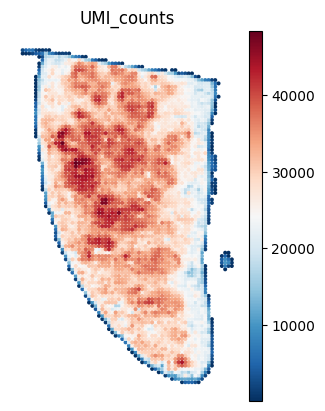

In [1]:
save_time = "20241206164031"

data_path = '/home/project/11003054/changxu/Data/Stereo_cite_seq/B05050G1/Stereo-CITE-seq'
data_name = "B05050G1_bin100"
methods = "Dirac"
save_path = f'/home/project/11003054/changxu/Projects/SpaGNNs/Review/Re_2024_10_29/mouse_spleen/Results/B05050G1_bin100_Dirac/{save_time}'

adata_RNA = sc.read(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
adata_Protein = sc.read(os.path.join(data_path, f"{data_name}_Protein.h5ad"))

adata_RNA.raw = adata_RNA.copy()
adata_Protein.raw = adata_Protein.copy()


# mitochondrial genes, "MT-" for human, "Mt-" for mouse
adata_RNA.var["mt"] = adata_RNA.var_names.str.startswith("MT-")
# ribosomal genes
adata_RNA.var["ribo"] = adata_RNA.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes
adata_RNA.var["hb"] = adata_RNA.var_names.str.contains("^HB[^(P)]")

sc.pp.calculate_qc_metrics(
    adata_RNA, qc_vars=["mt", "ribo", "hb"], inplace=True, log1p=True
)

sc.pl.violin(
    adata_RNA,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    show = False,
	stripplot=False,
    palette = "BuPu_r"
    
)
plt.savefig(os.path.join(save_path, f"{data_name}_RNA_violin_QC.pdf"), dpi=300)

sc.pl.spatial(adata_RNA, color=["total_counts", "n_genes_by_counts"], cmap = "BuPu_r", frameon=False, spot_size=120, show = False)

plt.savefig(os.path.join(save_path, f"{data_name}_RNA_spatial_QC.pdf"), dpi=300)

umi_counts = adata_Protein.X.sum(axis=1).A1 if hasattr(adata_Protein.X, "A1") else adata_Protein.X.sum(axis=1)
adata_Protein.obs["UMI_counts"] = umi_counts

sc.pl.violin(
    adata_Protein,
    ["UMI_counts"],
    show = False,
	stripplot=False,
    palette = ["#F7C4C1"]
)
plt.savefig(os.path.join(save_path, f"{data_name}_Protein_violin_QC.pdf"), dpi=300)

sc.pl.spatial(adata_Protein, color=["UMI_counts"], cmap = "RdBu_r", frameon=False, spot_size=120, show = False,)

plt.savefig(os.path.join(save_path, f"{data_name}_Protein_spatial_QC.pdf"), dpi=300)

## DIRAC's vertical integration of RNA + ADT data (bin50)

In [ ]:
data_path = '/home/project/11003054/changxu/Data/Stereo_cite_seq/B05050G1/Stereo-CITE-seq'
data_name = "B05050G1_bin50"
methods = "Dirac"
save_path = "/home/project/11003054/changxu/Projects/SpaGNNs/Review/Re_2024_10_29/mouse_spleen/Results"
now = time.strftime("%Y%m%d%H%M%S", time.localtime(time.time()))

save_path = os.path.join(save_path, f"{data_name}_{methods}", f"{now}")
if not os.path.exists(save_path):
	os.makedirs(save_path)

In [ ]:
adata_RNA = sc.read(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
adata_Protein = sc.read(os.path.join(data_path, f"{data_name}_Protein.h5ad"))

adata_RNA.raw = adata_RNA.copy()
adata_Protein.raw = adata_Protein.copy()

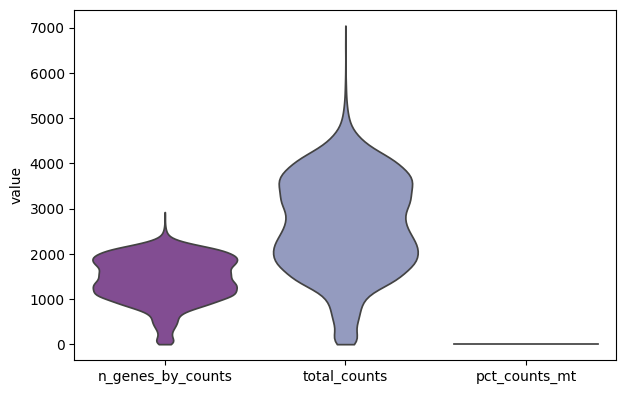

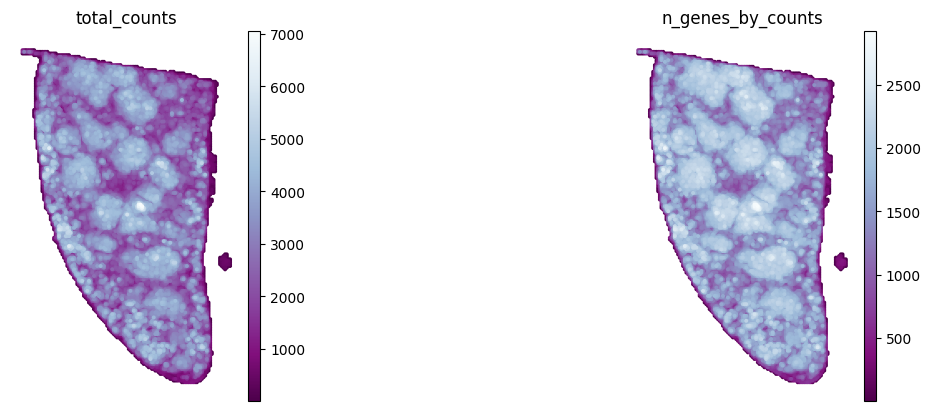

<Figure size 640x480 with 0 Axes>

In [ ]:
# mitochondrial genes, "MT-" for human, "Mt-" for mouse
adata_RNA.var["mt"] = adata_RNA.var_names.str.startswith("MT-")
# ribosomal genes
adata_RNA.var["ribo"] = adata_RNA.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes
adata_RNA.var["hb"] = adata_RNA.var_names.str.contains("^HB[^(P)]")

sc.pp.calculate_qc_metrics(
    adata_RNA, qc_vars=["mt", "ribo", "hb"], inplace=True, log1p=True
)

sc.pl.violin(
    adata_RNA,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    show = False,
	stripplot=False,
    palette = "BuPu_r"
    
)
plt.savefig(os.path.join(save_path, f"{data_name}_RNA_violin_QC.pdf"), dpi=300)

sc.pl.spatial(adata_RNA, color=["total_counts", "n_genes_by_counts"], cmap = "BuPu_r", frameon=False, spot_size=120)

plt.savefig(os.path.join(save_path, f"{data_name}_RNA_spatial_QC.pdf"), dpi=300)

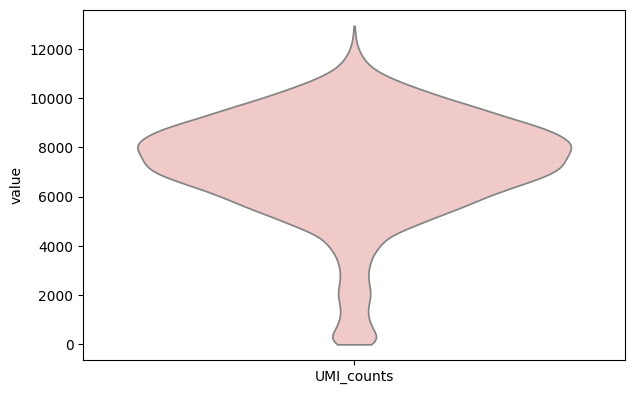

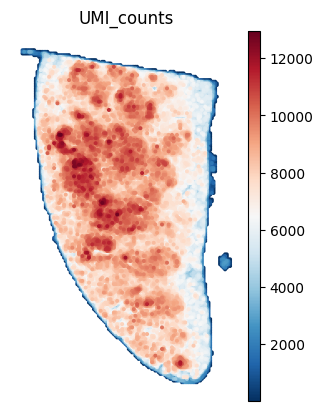

<Figure size 640x480 with 0 Axes>

In [ ]:
umi_counts = adata_Protein.X.sum(axis=1).A1 if hasattr(adata_Protein.X, "A1") else adata_Protein.X.sum(axis=1)
adata_Protein.obs["UMI_counts"] = umi_counts

sc.pl.violin(
    adata_Protein,
    ["UMI_counts"],
    show = False,
	stripplot=False,
    palette = ["#F7C4C1"]
)
plt.savefig(os.path.join(save_path, f"{data_name}_Protein_violin_QC.pdf"), dpi=300)

sc.pl.spatial(adata_Protein, color=["UMI_counts"], cmap = "RdBu_r", frameon=False, spot_size=120)

plt.savefig(os.path.join(save_path, f"{data_name}_Protein_spatial_QC.pdf"), dpi=300)

In [ ]:
adata_RNA.var_names = adata_RNA.var["real_gene_name"].astype(str)
# genes_to_remove = [gene for gene in adata_RNA.var_names if gene.startswith("Gm") or gene.startswith("Mt")]
# adata_RNA = adata_RNA[:, ~adata_RNA.var_names.isin(genes_to_remove)]
# genes_filter_out = pd.read_csv("/home/project/11003054/changxu/Data/Stereo_cite_seq/genes-filter-out.csv")
# genes_filter_list = genes_filter_out['genes'].tolist()
# adata_RNA = adata_RNA[:,~adata_RNA.var_names.isin(genes_filter_list)]
# print(f"Removing {len(genes_to_remove)+len(genes_filter_list)} genes that start with 'Gm' or 'Mt' or 'Rpl'" )
# adata_RNA.var_names_make_unique()

In [ ]:
common_index = adata_RNA.obs_names.intersection(adata_Protein.obs_names)
adata_RNA = adata_RNA[common_index]
adata_Protein = adata_Protein[common_index]

In [ ]:
print(adata_RNA)
print(adata_Protein)

View of AnnData object with n_obs × n_vars = 16477 × 26068
    obs: 'orig.ident', 'x', 'y', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'real_gene_name', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'spatial'
View of AnnData object with n_obs × n_vars = 16477 × 128
    obs: 'orig.ident', 'x', 'y', 'UMI_counts'
    var: 'real_gene_name'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'spatial'


In [ ]:
######### Data processing
adata_RNA.obs["Omics"] = data_name + "_mRNA"
adata_RNA.obs['Omics'] = adata_RNA.obs['Omics'].astype('category')
adata_Protein.obs["Omics"] = data_name + "_Protein"
adata_Protein.obs['Omics'] = adata_Protein.obs['Omics'].astype('category')

In [ ]:
######### Data processing
sc.pp.filter_genes(adata_RNA, min_cells=3)
sc.pp.normalize_total(adata_RNA, target_sum=1e4)
sc.pp.log1p(adata_RNA)
sc.pp.scale(adata_RNA)
sc.tl.pca(adata_RNA, n_comps=200)

In [ ]:
######### Data processing
sc.pp.normalize_total(adata_Protein, target_sum=1e4)
sc.pp.log1p(adata_Protein)
sc.pp.scale(adata_Protein)

In [ ]:
adata_RNA.obsm['spatial'] = adata_RNA.obsm['spatial'].astype('float32')
edge_index = sd.utils.get_single_edge_index(adata_RNA.obsm["spatial"].copy(), n_neighbors = 6, graph_methods = "knn")
print(len(edge_index)/adata_RNA.shape[0])
edge_index = torch.LongTensor(edge_index).T

6.0


In [ ]:
y = pd.Categorical(
            np.array(adata_RNA.obs["Omics"]),
            categories=np.unique(adata_RNA.obs["Omics"]),
        ).codes

In [ ]:
###### The GPU on the server is broken, FUCK!!!!!! Training Dirac for spatial multi-omics
dirac = sd.integrate_app(save_path = save_path, use_gpu = True, subgraph=True)
samples = dirac._get_data(dataset_list = [adata_RNA.obsm["X_pca"].copy(), adata_Protein.X.copy()],
							batch_list = [y, y],
							domain_list = [np.zeros(adata_RNA.shape[0]), np.ones(adata_Protein.shape[0])],
                            edge_index = edge_index,
							num_parts =  15,
							num_workers = 1,
							batch_size = 1,)
models = dirac._get_model(samples, 
						n_hiddens = 128,
        				n_outputs = 64,
        				opt_GNN = "GCN",) 
data_z, combine_recon, _ = dirac._train_dirac_integrate(samples = samples,
							models = models,
							epochs = 100,
                            lamb = 5e-3, 
                    		scale_loss = 0.5,
                            lr = 1e-3,
                            wd = 5e-2,
    						)

Found 2 unique domains.


Computing METIS partitioning...
Done!
Project..: 100%|█| 100/100 [00:46<00:00,  2.14it/s, Lo


In [ ]:
adata_RNA.obsm[f"{methods}_embed"] = data_z[: adata_RNA.shape[0], :]
adata_Protein.obsm[f"{methods}_embed"] = data_z[adata_RNA.shape[0] :, :]
adata_RNA.obsm["combine_recon"] = combine_recon
adata_Protein.obsm["combine_recon"] = combine_recon

fitting ...
  |======================================================================| 100%


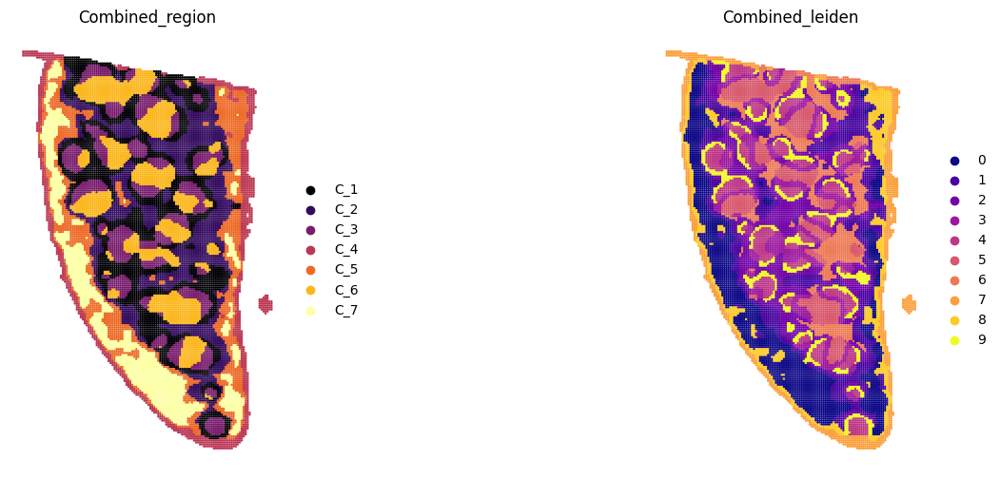

In [ ]:
####### Combined
n_clusters = 7
sc.pp.neighbors(adata_RNA, use_rep='combine_recon')
# res_RNA_Protein = _priori_cluster(adata_RNA, eval_cluster_n=n_clusters)
sc.tl.leiden(adata_RNA, resolution=0.2, key_added="Combined_leiden")
mclust_R(adata=adata_RNA, num_cluster=n_clusters, used_obsm="combine_recon", key_added="Combined_mclust")

adata_RNA.obs["Combined_region"] = "C_" + adata_RNA.obs["Combined_mclust"].astype(str)
adata_RNA.obs["Combined_region"] = adata_RNA.obs["Combined_region"].astype('category')
adata_RNA.uns["__type"] = 'UMI'

# Create a color dictionary for the "Combined_region" category
colors_list = plt.cm.get_cmap("inferno", len(adata_RNA.obs["Combined_region"].unique())).colors
color_dict = dict(zip(adata_RNA.obs["Combined_region"].cat.categories, colors_list))

# Set the number of panels and layout for the subplot
n_panels = 2
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Define color palettes and colormaps
colors = ["Combined_region", "Combined_leiden"]
colormaps = [color_dict, "plasma"]  # Example colormaps; modify as needed

# Plot each panel
for ax, color, cmap in zip(axs, colors, colormaps):
    sc.pl.spatial(adata_RNA, color=color, palette=cmap, frameon=False, spot_size=60, ax=ax, show=False)
    ax.set_title(color)

adata_RNA.uns["Combined_region_colors"] = color_dict

# Save the figure to the specified path with a filename including a timestamp; set high resolution and remove extra margins
file_name = f"{data_name}_{methods}_Combined_spatial_{now}.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)


In [ ]:
####### Save Data
adata_RNA.var.rename(columns={"real_gene_name": "real_gene_name_col"}, inplace=True)
adata_RNA.write(os.path.join(save_path,f"{data_name}_{methods}_RNA_{now}.h5ad"),compression="gzip")
adata_Protein.write(os.path.join(save_path,f"{data_name}_{methods}_Protein_{now}.h5ad"),compression="gzip")

In [ ]:
save_path

'/home/project/11003054/changxu/Projects/SpaGNNs/Review/Re_2024_10_29/mouse_spleen/Results/B05050G1_bin50_Dirac/20241206192908'

## Define spatial domains (bin50)

In [ ]:
import spateo as st

save_time = "20241206192908"

data_path = '/home/project/11003054/changxu/Data/Stereo_cite_seq/B05050G1/Stereo-CITE-seq'
data_name = "B05050G1_bin50"
methods = "Dirac"
save_path = f'/home/project/11003054/changxu/Projects/SpaGNNs/Review/Re_2024_10_29/mouse_spleen/Results/B05050G1_bin50_Dirac/{save_time}'

adata_RNA = sc.read(os.path.join(save_path,f"{data_name}_{methods}_RNA_{save_time}.h5ad"))
adata_Protein = sc.read(os.path.join(save_path,f"{data_name}_{methods}_Protein_{save_time}.h5ad"))

adata_RNA = adata_RNA.raw.to_adata()
adata_Protein = adata_Protein.raw.to_adata()
adata_RNA.var_names = adata_RNA.var["real_gene_name"].astype(str)

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.



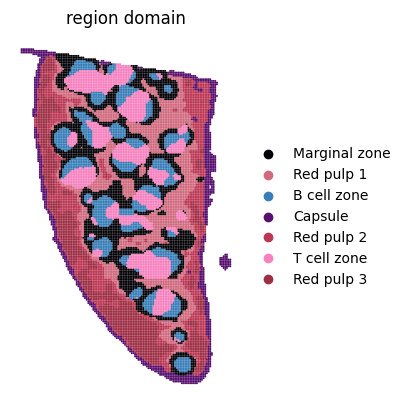

In [ ]:
# create a dictionary to map cluster to annotation label
cluster2annotation = {
    "C_1": "Marginal zone",
    "C_2": "Red pulp 1",
    "C_3": "B cell zone",
    "C_4": "Capsule",
    "C_5": "Red pulp 2",
    "C_6": "T cell zone",
    "C_7": "Red pulp 3",
}

# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata_RNA.obs["region domain"] = adata_RNA.obs['Combined_region'].map(cluster2annotation).astype("category")

########### save colors
cluster2colors = {
    "Marginal zone": '#000004ff',
    "Capsule": '#57106eff',
    "T cell zone": "#F781BF",
    "B cell zone": "#377EB8",
    "Red pulp 1":'#d16a7fff',
    "Red pulp 2":'#bc3754ff',
    "Red pulp 3":'#9e2e44ff',
}
sc.pl.spatial(adata_RNA, color=["region domain"], palette=cluster2colors, frameon=False, spot_size=60, show=False)
plt.savefig(os.path.join(save_path, f"{data_name}_bin50_region_domain.pdf"), dpi=300)

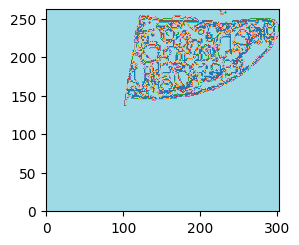

In [ ]:
adata_RNA.uns['__type'] = "UMI"
st.pl.spatial_domains(adata_RNA, bin_size=50, label_key="region domain", save_img=os.path.join(save_path, "spatial_domains.png"))

In [ ]:

adata_RNA.obsm['spatial_bin50'] = adata_RNA.obsm['spatial']//50

adata_RNA = st.io.read_image(
    adata_RNA,
    filename=os.path.join(save_path, "spatial_domains.png"),
    img_layer="layer1",
    slice="slice1",
    scale_factor=1,
)

cluster2colors = {
    "Marginal zone": '#000004ff',
    "Capsule": '#57106eff',
    "T cell zone": "#F781BF",
    "B cell zone": "#377EB8",
    "Red pulp 1":'#d16a7fff',
    "Red pulp 2":'#bc3754ff',
    "Red pulp 3":'#9e2e44ff',
}

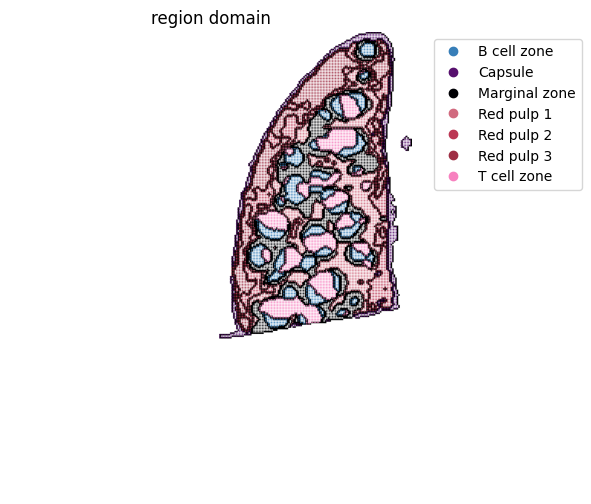

<Figure size 640x480 with 0 Axes>

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA,
    space="spatial_bin50",
    color=["region domain"],
    alpha=0.9,
    figsize=(5, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    dpi=300, 
    pointsize=0.02,
    color_key = cluster2colors,
    ax=ax,
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains.png"))

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/spateo/plotting/static/scatters.py:880: ImplicitModificationWarning:

Trying to modify attribute `._uns` of view, initializing view as actual.

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.



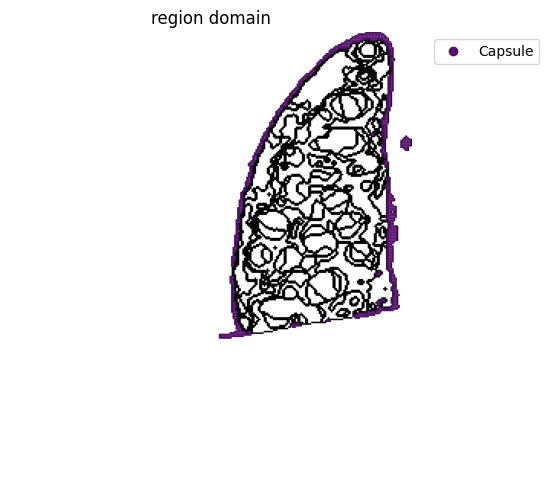

<Figure size 640x480 with 0 Axes>

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/spateo/plotting/static/scatters.py:880: ImplicitModificationWarning:

Trying to modify attribute `._uns` of view, initializing view as actual.

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.



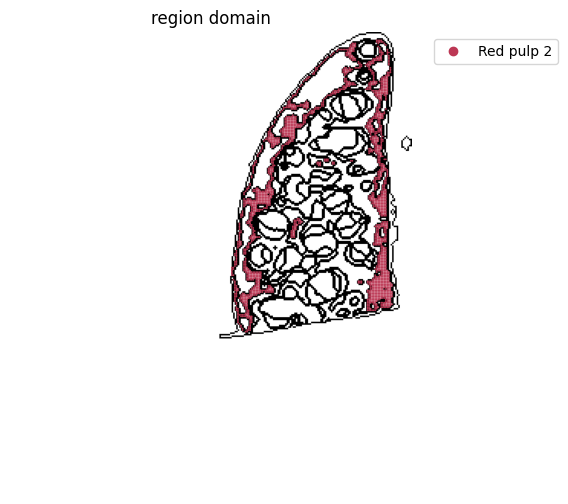

<Figure size 640x480 with 0 Axes>

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/spateo/plotting/static/scatters.py:880: ImplicitModificationWarning:

Trying to modify attribute `._uns` of view, initializing view as actual.

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.



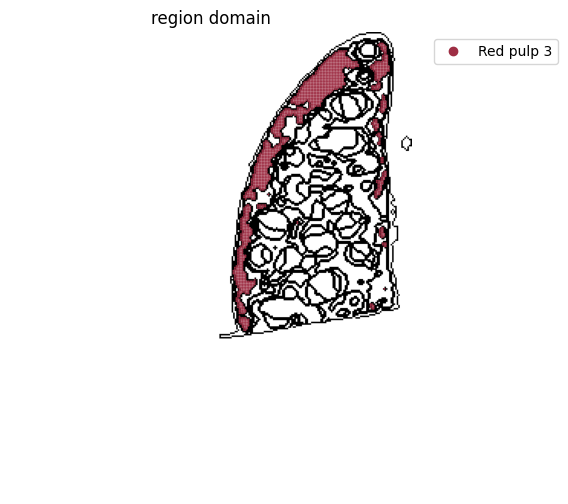

<Figure size 640x480 with 0 Axes>

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/spateo/plotting/static/scatters.py:880: ImplicitModificationWarning:

Trying to modify attribute `._uns` of view, initializing view as actual.

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.



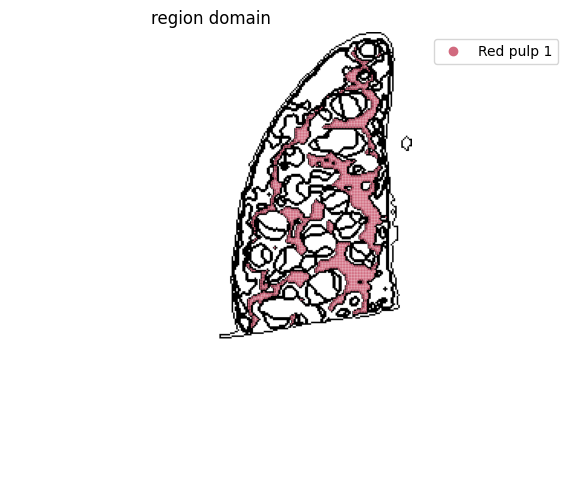

<Figure size 640x480 with 0 Axes>

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/spateo/plotting/static/scatters.py:880: ImplicitModificationWarning:

Trying to modify attribute `._uns` of view, initializing view as actual.

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.



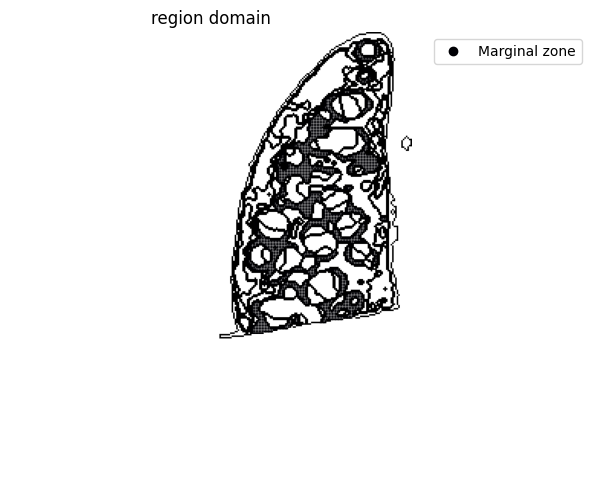

<Figure size 640x480 with 0 Axes>

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/spateo/plotting/static/scatters.py:880: ImplicitModificationWarning:

Trying to modify attribute `._uns` of view, initializing view as actual.

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.



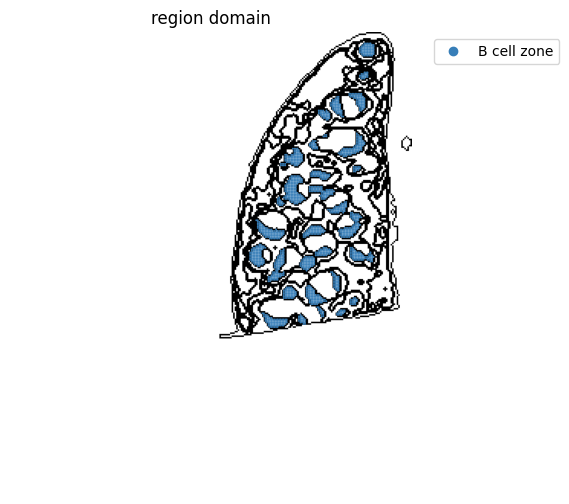

<Figure size 640x480 with 0 Axes>

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/spateo/plotting/static/scatters.py:880: ImplicitModificationWarning:

Trying to modify attribute `._uns` of view, initializing view as actual.

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.



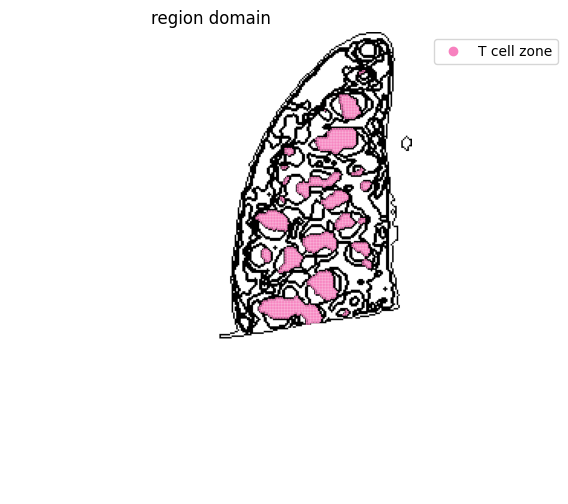

<Figure size 640x480 with 0 Axes>

In [ ]:
for i in adata_RNA.obs["region domain"].unique():
    fig, ax = plt.subplots(figsize=(8, 6))
    st.pl.space(
        adata_RNA[adata_RNA.obs["region domain"].isin([i]), :],
        space="spatial_bin50",
        color=["region domain"],
        alpha=0.95,
        pointsize=0.02,
        figsize=(4, 3),
        show_legend="upper left",
        img_layers = "layer1",
        slices="slice1",
        color_key = cluster2colors,
        ax = ax
    )
    plt.tight_layout()
    plt.show() 
    fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_{i}.png"))

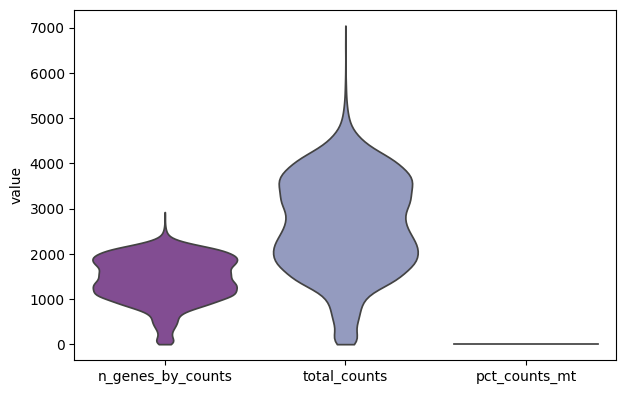

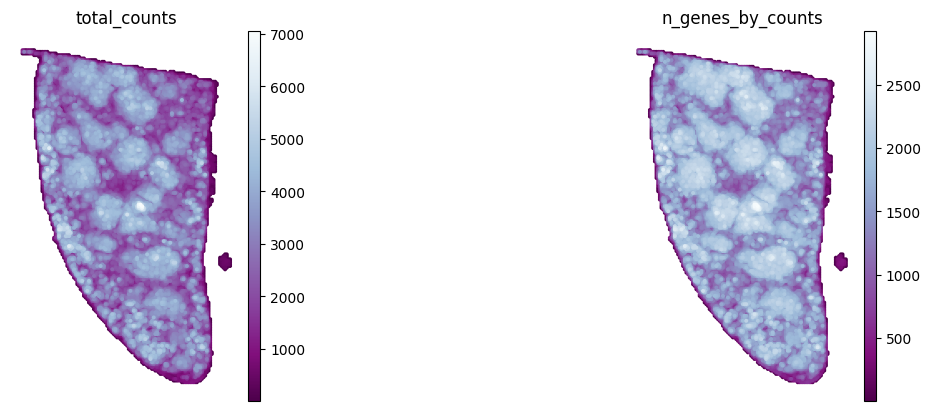

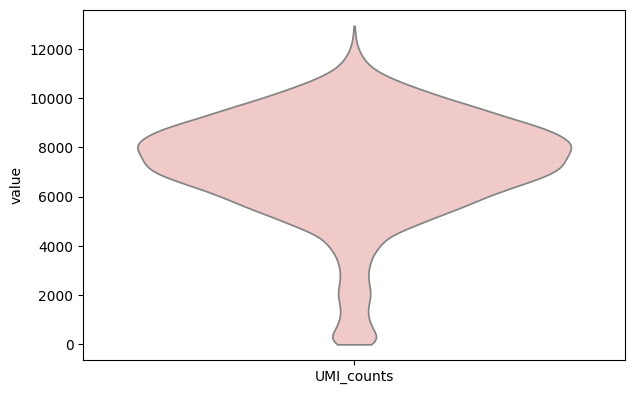

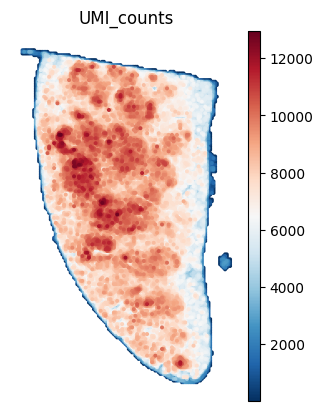

In [ ]:
save_time = "20241206192908"

data_path = '/home/project/11003054/changxu/Data/Stereo_cite_seq/B05050G1/Stereo-CITE-seq'
data_name = "B05050G1_bin50"
methods = "Dirac"
save_path = f'/home/project/11003054/changxu/Projects/SpaGNNs/Review/Re_2024_10_29/mouse_spleen/Results/B05050G1_bin50_Dirac/{save_time}'

adata_RNA = sc.read(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
adata_Protein = sc.read(os.path.join(data_path, f"{data_name}_Protein.h5ad"))

adata_RNA.raw = adata_RNA.copy()
adata_Protein.raw = adata_Protein.copy()


# mitochondrial genes, "MT-" for human, "Mt-" for mouse
adata_RNA.var["mt"] = adata_RNA.var_names.str.startswith("MT-")
# ribosomal genes
adata_RNA.var["ribo"] = adata_RNA.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes
adata_RNA.var["hb"] = adata_RNA.var_names.str.contains("^HB[^(P)]")

sc.pp.calculate_qc_metrics(
    adata_RNA, qc_vars=["mt", "ribo", "hb"], inplace=True, log1p=True
)

sc.pl.violin(
    adata_RNA,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    show = False,
	stripplot=False,
    palette = "BuPu_r"
    
)
plt.savefig(os.path.join(save_path, f"{data_name}_RNA_violin_QC.pdf"), dpi=300)

sc.pl.spatial(adata_RNA, color=["total_counts", "n_genes_by_counts"], cmap = "BuPu_r", frameon=False, spot_size=120, show = False)

plt.savefig(os.path.join(save_path, f"{data_name}_RNA_spatial_QC.pdf"), dpi=300)

umi_counts = adata_Protein.X.sum(axis=1).A1 if hasattr(adata_Protein.X, "A1") else adata_Protein.X.sum(axis=1)
adata_Protein.obs["UMI_counts"] = umi_counts

sc.pl.violin(
    adata_Protein,
    ["UMI_counts"],
    show = False,
	stripplot=False,
    palette = ["#F7C4C1"]
)
plt.savefig(os.path.join(save_path, f"{data_name}_Protein_violin_QC.pdf"), dpi=300)

sc.pl.spatial(adata_Protein, color=["UMI_counts"], cmap = "RdBu_r", frameon=False, spot_size=120, show = False,)

plt.savefig(os.path.join(save_path, f"{data_name}_Protein_spatial_QC.pdf"), dpi=300)